# Preamble

In [1]:
using Plots, DifferentialEquations, QuadGK, MultiQuad, Interpolations, SymPy, LaTeXStrings
default(framestyle=:box, guidefont=font(14), titlefont=font(14), tickfont=font(12), legend_font=font(12), legend=false);

In [2]:
Mpl = 2.435e18; # reduced Planck mass in GeV
c = 299792458; # speed of light in m/s
KinGeV = (1.160e4)^-1 * 10^-9; # Kelvin in GeV
Mpcinm = 3.086e16 * 10^6; # Mpc in m
GeVinminv = 10^9/(1.973e-7); # GeV in m^-1
GeVinMpcinv = GeVinminv * Mpcinm; # GeV in Mpc^-1
MpcinvinHz = c/Mpcinm; # Mpc^inv in Hz
yrins = 365.2422 * 24 * 60 * 60; # yr in s

Or0h2 = 4.2e-5; # current radiation density parameter * h^2
Hubblh = 0.674; # normalised Hubble parameter h

# Background

## calculation

In [211]:
ai = [1, 1.11724, 3.12672e-1, -4.68049e-2, -2.65004e-2, -1.19760e-3, 1.82812e-4, 1.36436e-4, 8.55051e-5, 1.22840e-5, 3.82259e-7, -6.87035e-9];
bi = [1.43382e-2, 1.37559e-2, 2.92108e-3, -5.38533e-4, -1.62496e-4, -2.87906e-5, -3.84278e-6, 2.78776e-6, 7.40342e-7, 1.17210e-7, 3.72499e-9, -6.74107e-11];
ci = [1, 6.07869e-1, -1.54485e-1, -2.24034e-1, -2.82147e-2, 2.90620e-2, 6.86778e-3, -1.00005e-3, -1.69104e-4, 1.06301e-5, 1.69528e-6, -9.33311e-8];
di = [7.07388e1, 9.18011e1, 3.31892e1, -1.39779, -1.52558, -1.97857e-2, -1.60146e-1, 8.22615e-5, 2.02651e-2, -1.82134e-5, 7.83943e-5, 7.13518e-5];

In [212]:
Tth = 0.12; # temperature separation in GeV

In [213]:
grhohigh(T) = sum([ai[i]*log(T)^(i - 1) for i=1:12]) / sum([bi[i]*log(T)^(i - 1) for i=1:12]); # eff. DoF for energy density for T > 0.12 GeV
gshigh(T) = grhohigh(T) / (1 + sum([ci[i]*log(T)^(i - 1) for i=1:12]) / sum([di[i]*log(T)^(i - 1) for i=1:12])); # eff. DoF for entropy for T > 0.12 GeV

In [214]:
rhohigh(T) = π^2/30*grhohigh(T)*T^4; # energy density for T > 0.12 GeV
shigh(T) = 2*π^2/45*gshigh(T)*T^3; # entropy for T > 0.12 GeV
phigh(T) = T*shigh(T) - rhohigh(T); # pressure for T > 0.12 GeV

In [215]:
# some fitting functions
Sfit(x) = 1 + 7/4*exp(-1.0419*x) * (1 + 1.034*x + 0.456426*x^2 + 0.0595249*x^3);
frho(x) = exp(-1.04855*x) * (1 + 1.03757*x + 0.508630*x^2 + 0.0893988*x^3);
brho(x) = exp(-1.03149*x) * (1 + 1.03317*x + 0.398264*x^2 + 0.0648056*x^3);
fs(x) = exp(-1.04190*x) * (1 + 1.03400*x + 0.456426*x^2 + 0.0595248*x^3);
bs(x) = exp(-1.03365*x) * (1 + 1.03397*x + 0.342548*x^2 + 0.0506182*x^3);

In [216]:
# mass params. in GeV
me = 511e-6;
mmu = 0.1056;
mpi0 = 0.13;
mpipm = 0.140;
m1 = 0.5;
m2 = 0.77;
m3 = 1.2;
m4 = 2;

In [217]:
# neutrino temperature
Tnu(T) = (4/11)^(1/3) * Sfit(me/T)^(1/3) * T;

In [218]:
grhogammalow(T) = 2.030 + 3.495*frho(me/T) + 3.446*frho(mmu/T) + 1.05*brho(mpi0/T) + 2.08*brho(mpipm/T) + 4.165*brho(m1/T) + 30.55*brho(m2/T) + 89.4*brho(m3/T) + 8209*brho(m4/T); # eff. DoF for photon energy density for T < 0.12 GeV
gsgammalow(T) = 2.008 + 3.442*fs(me/T) + 3.468*fs(mmu/T) + 1.034*bs(mpi0/T) + 2.068*bs(mpipm/T) + 4.16*bs(m1/T) + 30.55*bs(m2/T) + 90*bs(m3/T) + 6209*bs(m4/T); # eff. DoF for photon entropy for T < 0.12 GeV
grhonulow(T) = 1.353*Sfit(me/T)^(4/3); # eff. DoF for neutrino energy density for T < 0.12 GeV
gsnulow(T) = 1.923*Sfit(me/T); # eff. DoF for neutrino entropy for T < 0.12 GeV

In [219]:
# T < 0.12 GeV
rhogammalow(T) = π^2/30*grhogammalow(T)*T^4; # photon energy density
sgammalow(T) = 2*π^2/45*gsgammalow(T)*T^3; # photon entropy
rhonulow(T) = π^2/30*grhonulow(T)*T^4; # neutrino energy density
snulow(T) = 2*π^2/45*gsnulow(T)*T^3; # neutrino entropy
pgammalow(T) = T*sgammalow(T) - rhogammalow(T); # photon pressure
pnulow(T) = Tnu(T)*snulow(T) - rhonulow(T); # neutrino pressure
rholow(T) = rhogammalow(T) + rhonulow(T); # total energy density
plow(T) = pgammalow(T) + pnulow(T); # total pressure

In [220]:
function grho(T) # eff. DoF for energy density
    if T >= Tth
        return grhohigh(T)
    else
        return grhogammalow(T) + grhonulow(T)
    end
end;

function grhop(T) # T-derivative of grho
    Tp = symbols("Tp")
    if T >= Tth
        return diff(grhohigh(Tp)).subs(Tp,T)
    else
        return diff(grhogammalow(Tp) + grhonulow(Tp)).subs(Tp,T) 
    end
end;

function gs(T) # eff. DoF for entropy
    if T >= Tth
        return gshigh(T)
    else
        return gsgammalow(T) + gsnulow(T)
    end
end;

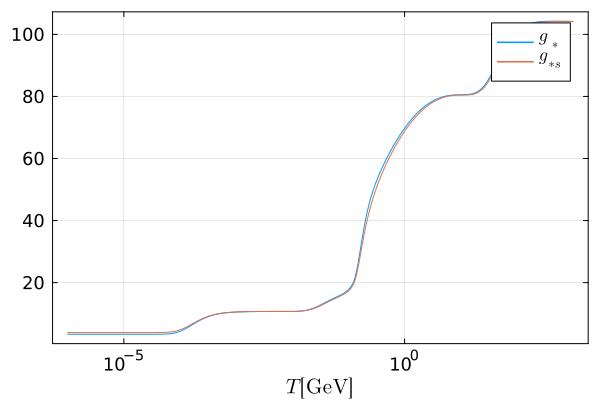

In [227]:
Tlist = [10^i for i=-6:0.01:3]
plot(grho, Tlist, xscale=:log10, label=L"$g_*$", xlabel=L"$T\,[\mathrm{GeV}]$")
plot!(gs, Tlist, label=L"$g_{*s}$")

In [228]:
function rho(T) # energy density
    if T >= Tth
        return rhohigh(T)
    else 
        return rholow(T)
    end
end;

function press(T) # pressure
    if T >= Tth
        return phigh(T)
    else
        return plow(T)
    end
end;

In [229]:
EoSw(T) = press(T)/rho(T); # equation-of-state param. w

function cs2(T) # sound speed squared
    Tp = symbols("Tp")
    if T >= Tth
        return (diff(phigh(Tp))/diff(rhohigh(Tp))).subs(Tp,T)
    else
        return (diff(plow(Tp))/diff(rholow(Tp))).subs(Tp,T)
    end
end;

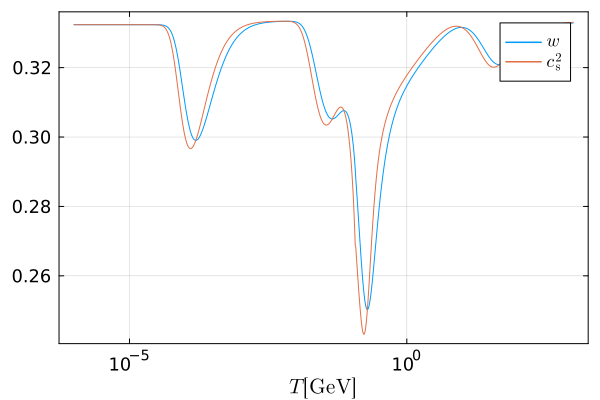

In [231]:
plot(EoSw, Tlist, xscale=:log10, label=L"$w$", xlabel=L"$T\,[\mathrm{GeV}]$")
plot!(cs2, Tlist, label=L"$c_\mathrm{s}^2$")

In [232]:
T0 = 2.725*KinGeV; # current temperature
grho0 = grho(T0); # current grho
gs0 = gs(T0); # current gs

In [233]:
calH(T, scalea) = scalea * sqrt(rho(T)/3/Mpl^2) * GeVinMpcinv; # conformal Hubble in Mpc^-1

In [234]:
Ti = 1e6; # initial temperature
scaleai = (gs0/gs(Ti))^(1/3)*T0/Ti; # temporal initial scale factor 
etai = 1/calH(Ti, scaleai); # initial conformal time

etaf = 10; # final conformal time

In [235]:
function bgEoM(du,u,p,lneta) # u[1] = T, u[2] = scalea
    du[1] = -3*exp(lneta)*(1 + EoSw(u[1])) * calH(u[1], u[2]) * grho(u[1]) / (grhop(u[1]) + 4*grho(u[1])/u[1])
    du[2] = exp(lneta)*u[2]*calH(u[1],u[2])
end;

ui = [Ti,scaleai];
lnetaspan = (log(etai),log(etaf));
bgprob = ODEProblem(bgEoM,ui,lnetaspan);
@time bgsol = solve(bgprob,Tsit5(),reltol=1e-10,abstol=1e-10);

 53.678137 seconds (13.27 M allocations: 450.058 MiB, 0.29% gc time, 0.73% compilation time)


In [236]:
Tsol(eta) = bgsol(log(eta))[1];
asol(eta) = bgsol(log(eta))[2];

In [237]:
norm = Tsol(etaf)/T0*asol(etaf); # renormalisation factor so that a0 = 1
anorm(eta) = asol(eta/norm)/norm; # renormalised scale factor
Tnorm(eta) = Tsol(eta/norm); # T with the renormalised eta
calHnorm(eta) = calH(Tnorm(eta), anorm(eta)); # calH with the renormalised eta
af = anorm(norm*etaf); # renormalised scale factor at the final time
calHf = calHnorm(norm*etaf); # calH at the final time

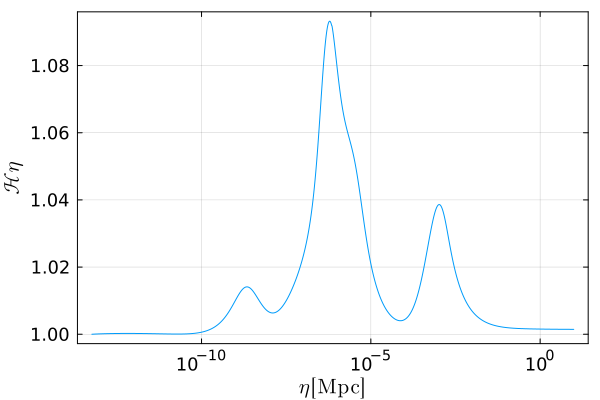

In [238]:
etalist = [10^i for i=log10(norm*etai):0.01:log10(norm*etaf)];
plot(etalist, map(x -> x*calHnorm(x), etalist), xscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$\mathcal{H}\eta$", legend=false)

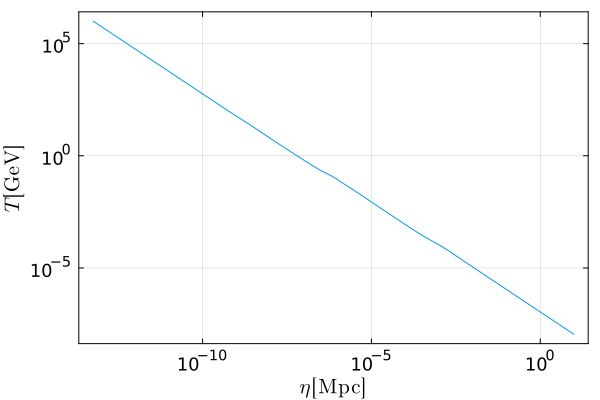

In [239]:
plot(Tnorm, etalist, xscale=:log10, yscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$T\,[\mathrm{GeV}]$", legend=false)

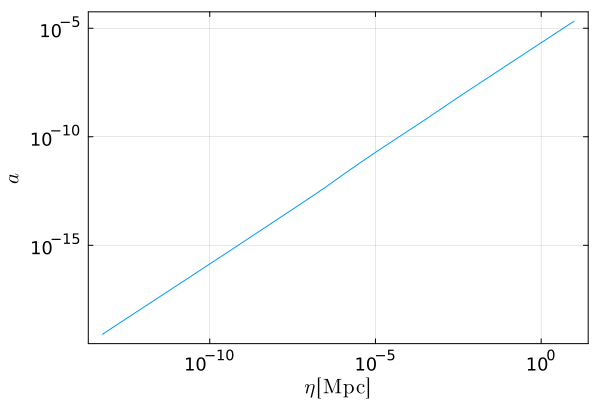

In [240]:
plot(anorm, etalist, xscale=:log10, yscale=:log10, xlabel=L"$\eta\,[\mathrm{Mpc}]$", ylabel=L"$a$", legend=false)

In [70]:
EoSwsol(eta) = EoSw(Tnorm(eta));
cs2sol(eta) = cs2(Tnorm(eta));
grhosol(eta) = grho(Tnorm(eta));
gssol(eta) = gs(Tnorm(eta));

In [71]:
lnetaspan = log10(norm*etai):0.01:log10(norm*etaf)

lnetaList = [lneta for lneta in lnetaspan];
anormList = [anorm(10^lneta) for lneta in lnetaspan];
calHList = [calHnorm(10^lneta) for lneta in lnetaspan];
EoSwList = [EoSwsol(10^lneta) for lneta in lnetaspan];
cs2List = [cs2sol(10^lneta) for lneta in lnetaspan];
grhoList = [grhosol(10^lneta) for lneta in lnetaspan];
gsList = [gssol(10^lneta) for lneta in lnetaspan];

In [72]:
open("bg.dat","w") do out
    Base.print_array(out, hcat(lnetaList[:],anormList[:],calHList[:],EoSwList[:],cs2List[:],grhoList[:],gsList[:]))
end

## load

In [3]:
f = open("data/bg.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnetaList = [numarray[i][1] for i=1:length(numarray)];
anormList = [numarray[i][2] for i=1:length(numarray)];
calHList = [numarray[i][3] for i=1:length(numarray)];
EoSwList = [numarray[i][4] for i=1:length(numarray)];
cs2List = [numarray[i][5] for i=1:length(numarray)];
grhoList = [numarray[i][6] for i=1:length(numarray)];
gsList = [numarray[i][7] for i=1:length(numarray)];

In [4]:
lnetaspan = range(lnetaList[1], lnetaList[length(lnetaList)], length=length(lnetaList))
etaf = 10^lnetaList[length(lnetaList)];

aCSI = CubicSplineInterpolation(lnetaspan, anormList);
aint(eta) = aCSI(log10(eta));

calHCSI = CubicSplineInterpolation(lnetaspan, calHList);
calHint(eta) = calHCSI(log10(eta));

EoSwCSI = CubicSplineInterpolation(lnetaspan, EoSwList);
EoSwint(eta) = EoSwCSI(log10(eta));

cs2CSI = CubicSplineInterpolation(lnetaspan, cs2List);
cs2int(eta) = cs2CSI(log10(eta));

grhoCSI = CubicSplineInterpolation(lnetaspan, grhoList);
grhoint(eta) = grhoCSI(log10(eta));

gsCSI = CubicSplineInterpolation(lnetaspan, gsList);
gsint(eta) = gsCSI(log10(eta));

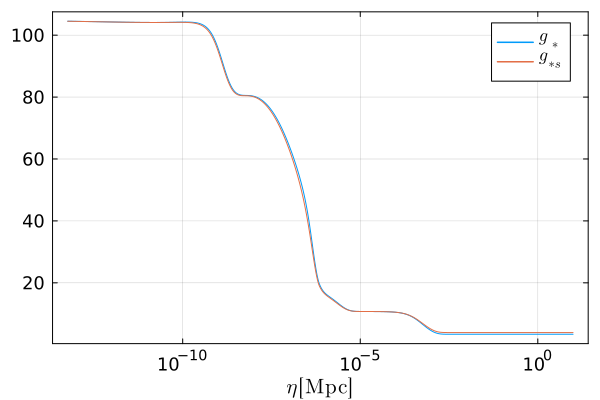

In [5]:
etaList = [10^lnetaList[i] for i=1:length(lnetaList)];
plot(grhoint, etaList, xscale=:log10, label=L"$g_*$", xlabel=L"$\eta\,[\mathrm{Mpc}]$", legend=true)
plot!(gsint, etaList, label=L"$g_{*s}$")

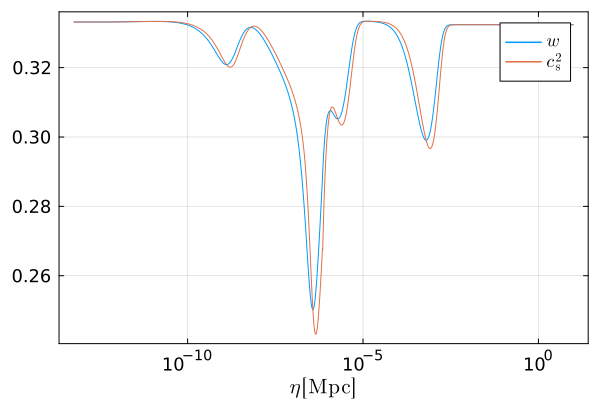

In [6]:
plot(EoSwint, etaList, xscale=:log10, label=L"$w$", xlabel=L"$\eta\,[\mathrm{Mpc}]$", legend=true)
plot!(cs2int, etaList, label=L"$c_\mathrm{s}^2$")

# Scalar

## calculation

In [345]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

In [346]:
function scalarEoM(du,u,p,x) # u[1] = Phi, u[2] = dPhidx, p[1] = k
    eta = x/p[1]
    du[1] = u[2]
    du[2] = - 3*calHint(eta)/p[1]*(1 + cs2int(eta))*u[2] - (cs2int(eta) + 3*calHint(eta)^2/p[1]^2*(cs2int(eta) - EoSwint(eta)))*u[1]
end;

ui = [1,0];
xspan = (xi,xf);

function scalarList()
    scalarList = []
    Threads.@threads for i=1:length(kList)
        p = [kList[i]]
        scalarprob = ODEProblem(scalarEoM,ui,xspan,p)
        scalarsol = solve(scalarprob,Tsit5(),reltol=1e-10,abstol=1e-10)
        Phisol(x) = scalarsol(x)[1]
        Pisol(x) = scalarsol(x)[2]
        push!(scalarList, [p[1],Phisol,Pisol])
    end
    sort!(scalarList, by =x -> x[1])
    return scalarList
end;

In [358]:
@time scalarsol = scalarList();

  3.941764 seconds (143.25 M allocations: 2.609 GiB, 83.78% gc time)


In [359]:
length(scalarsol)

501

In [348]:
PhiRD(x) = 9/x^2 * (sin(x/sqrt(3))/(x/sqrt(3)) - cos(x/sqrt(3))); # Phi in exact RD

function PhipRD(x) # (x=kη)-derivative of Phi in exact RD
    xp = symbols("xp")
    return diff(PhiRD(xp)).subs(xp,x)
end;

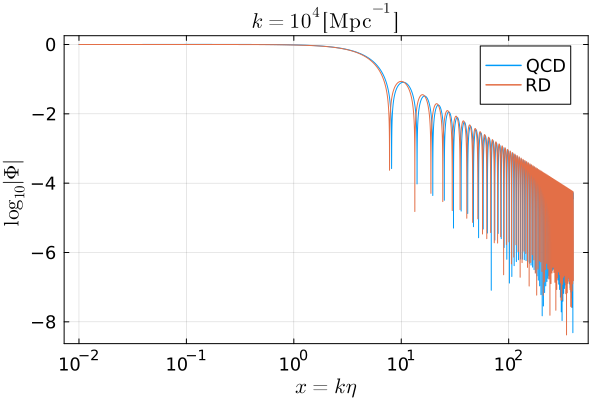

In [363]:
plot(xList, [log10(abs(scalarsol[1][2](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label="QCD", legend=true)
plot!(xList, [log10(abs(PhiRD(xList[i]))) for i=1:length(xList)], label="RD")

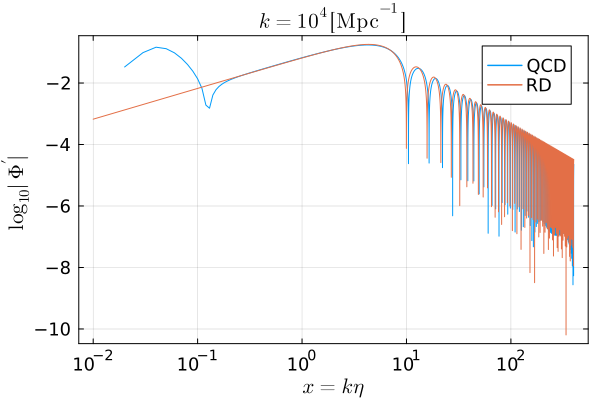

In [364]:
plot(xList, [log10(abs(scalarsol[1][3](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label="QCD", 
    legend=true)
plot!(xList, [log10(abs(PhipRD(xList[i]))) for i=1:length(xList)], label = "RD")

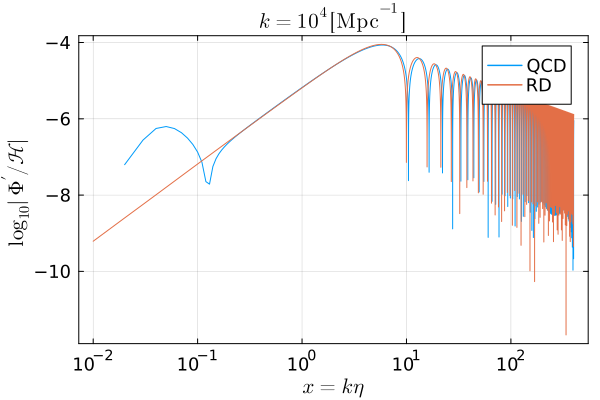

In [365]:
plot(xList, [log10(abs(scalarsol[1][3](xList[i]) / calHint(xList[i]/kList[1]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi^\prime/\mathcal{H}|$", 
    title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label="QCD", legend=true)
plot!(xList, [log10(abs(PhipRD(xList[i]) / calHint(xList[i]/kList[1]))) for i=1:length(xList)], label = "RD")

In [360]:
open("Phi.dat","w") do out
    Base.print_array(out, [scalarsol[j][2](xList[i]) for i=1:length(xList), j=1:length(kList)])
end;

open("Pi.dat","w") do out
    Base.print_array(out, [scalarsol[j][3](xList[i]) for i=1:length(xList), j=1:length(kList)])
end;

## load

In [7]:
f = open("data/Phi.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

PhiList = reduce(hcat,numarray);

f = open("data/Pi.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

PiList = reduce(hcat,numarray);

In [8]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

PhiCSI = CubicSplineInterpolation((lnkspan, xspan), PhiList);
Phiint(k,x) = PhiCSI(log10(k),x);

PiCSI = CubicSplineInterpolation((lnkspan, xspan), PiList);
Piint(k,x) = PiCSI(log10(k),x);

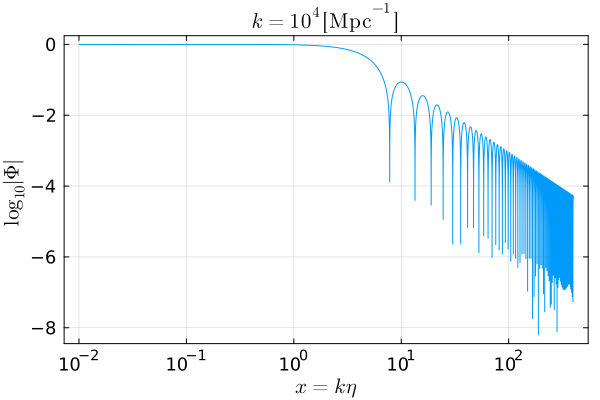

In [9]:
plot(xList, [log10(abs(Phiint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi|$", title=L"$k = 10^4\,[\mathrm{Mpc}^{-1}]$")

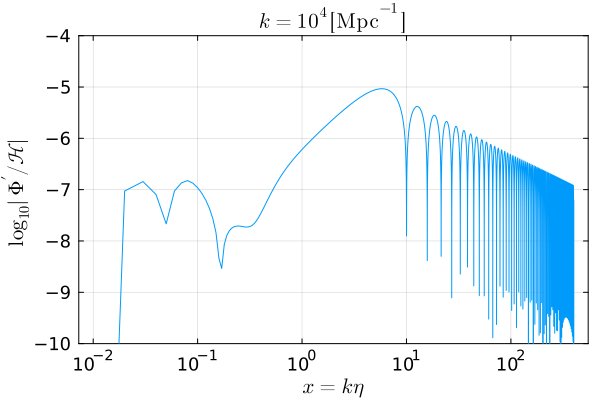

In [10]:
plot(xList, [log10(abs(Piint(1e5,xList[i]) / calHint(xList[i]/1e5))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|\Phi^\prime / \mathcal{H}|$", 
    title=L"$k = 10^4 \,[\mathrm{Mpc}^{-1}]$", ylims=(-10,-4))

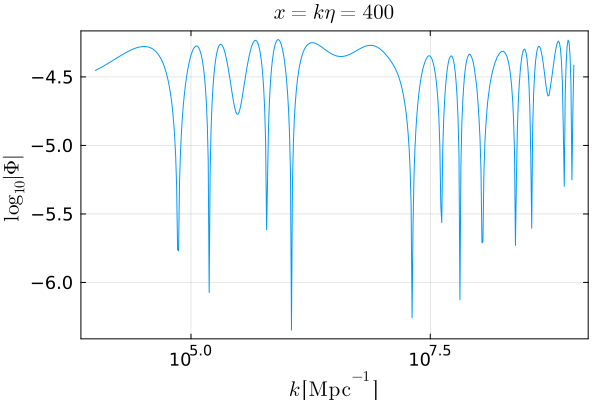

In [11]:
plot(kList, [log10(abs(Phiint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k\,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|\Phi|$", title=L"$x = k\eta = 400$")

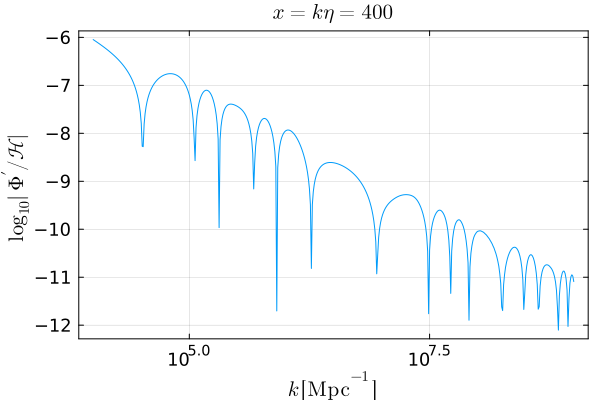

In [12]:
plot(kList, [log10(abs(Piint(kList[i],xf) / calHint(xf/kList[i]))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k \,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|\Phi^\prime / \mathcal{H}|$", 
    title=L"$x = k\eta = 400$")

# Tensor

## calculation

In [370]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

In [371]:
function gkEoM(du,u,p,x) # u[1] = g, u[2] = dgdx, p[1] = k
    du[1] = u[2]
    du[2] = - (1 - (1-3*EoSwint(x/p[1]))/2*calHint(x/p[1])^2/p[1]^2)*u[1]
end;

xspan = (xi, xf);

function gkList(ui)
    gkList = []
    Threads.@threads for i=1:length(kList)
        p = [kList[i]]
        tensorprob = ODEProblem(gkEoM,ui,xspan,p)
        tensorsol = solve(tensorprob,Tsit5(),reltol=1e-10,abstol=1e-10)
        gsol(x) = tensorsol(x)[1]
        gpsol(x) = tensorsol(x)[2]
        push!(gkList, [p[1],gsol,gpsol])
    end
    sort!(gkList, by =x -> x[1])
    return gkList
end;

In [382]:
ui1 = [1,0];
ui2 = [0,1];

@time g1sol = gkList(ui1);
@time g2sol = gkList(ui2);

 31.575796 seconds (616.08 M allocations: 12.805 GiB, 89.35% gc time)
 27.464415 seconds (562.77 M allocations: 11.643 GiB, 90.30% gc time)


In [383]:
length(g1sol)

501

In [384]:
length(g2sol)

501

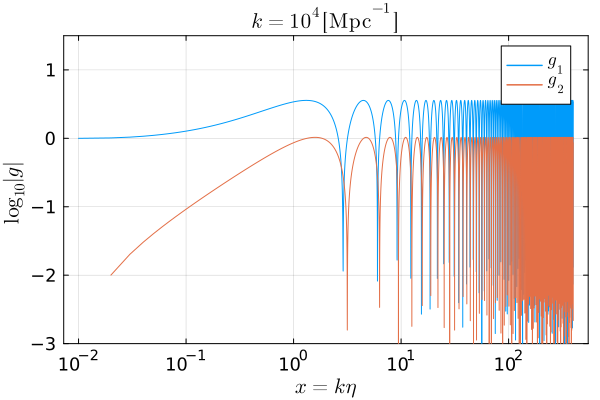

In [378]:
plot(xList, [log10(abs(g1sol[1][2](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", ylims = (-3,1.5), 
    legend=true)
plot!(xList, [log10(abs(g2sol[1][2](xList[i]))) for i=1:length(xList)], label=L"$g_2$")

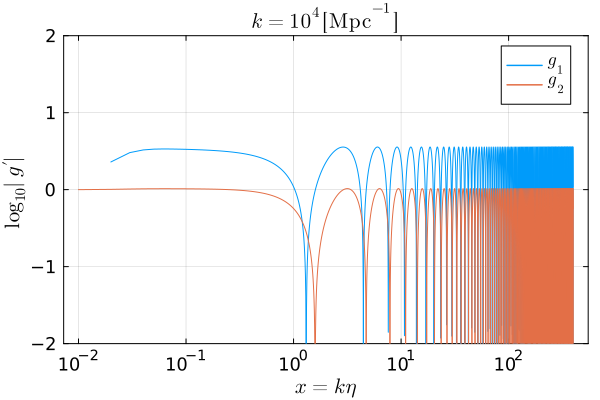

In [379]:
plot(xList, [log10(abs(g1sol[1][3](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    ylims = (-2,2), legend=true)
plot!(xList, [log10(abs(g2sol[1][3](xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

In [385]:
open("g1.dat","w") do out
    Base.print_array(out, [g1sol[j][2](xList[i]) for i=1:length(xList), j=1:length(kList)])
end;

open("g1p.dat","w") do out
    Base.print_array(out, [g1sol[j][3](xList[i]) for i=1:length(xList), j=1:length(kList)])
end;

open("g2.dat","w") do out
    Base.print_array(out, [g2sol[j][2](xList[i]) for i=1:length(xList), j=1:length(kList)])
end;

open("g2p.dat","w") do out
    Base.print_array(out, [g2sol[j][3](xList[i]) for i=1:length(xList), j=1:length(kList)])
end;

In [386]:
function hkEoM(du,u,p,x) # u[1] = h, u[2] = dhdx, p[1] = k
    du[1] = u[2]
    du[2] = -2*calHint(x/p[1])/p[1]*u[2] - u[1]
end;

xspan = (xi, xf);
ui = [1,0];

function hkList()
    hkList = []
    Threads.@threads for i=1:length(kList)
        p = [kList[i]]
        tensorprob = ODEProblem(hkEoM,ui,xspan,p)
        tensorsol = solve(tensorprob,Tsit5(),reltol=1e-10,abstol=1e-10)
        hsol(x) = tensorsol(x)[1]
        hpsol(x) = tensorsol(x)[2]
        push!(hkList, [p[1],hsol,hpsol])
    end
    sort!(hkList, by =x -> x[1])
    return hkList
end;

In [389]:
@time hksol = hkList();

  7.620778 seconds (143.71 M allocations: 3.499 GiB, 92.08% gc time)


In [390]:
length(hksol)

501

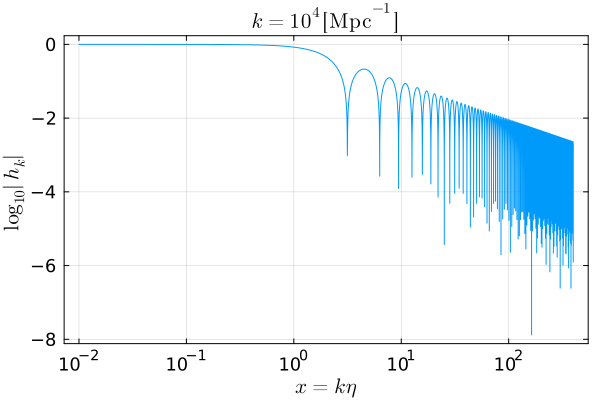

In [391]:
plot(xList, [log10(abs(hksol[1][2](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|h_k|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

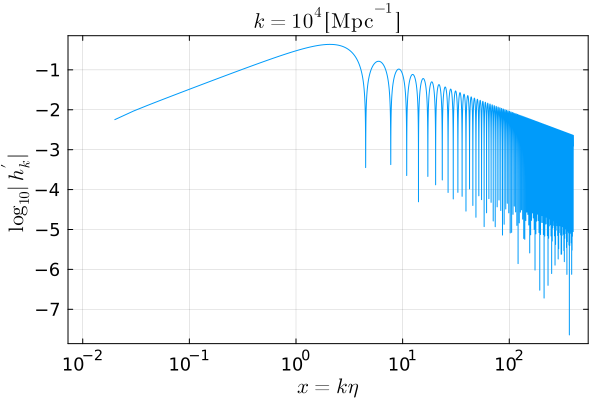

In [392]:
plot(xList, [log10(abs(hksol[1][3](xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|h_k^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

In [393]:
open("hk.dat","w") do out
    Base.print_array(out, [hksol[j][2](xList[i]) for i=1:length(xList), j=1:length(kList)])
end;

open("hkp.dat","w") do out
    Base.print_array(out, [hksol[j][3](xList[i]) for i=1:length(xList), j=1:length(kList)])
end;

In [70]:
f = open("data/g1.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

g1List = reduce(hcat,numarray);


f = open("data/g1p.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

g1pList = reduce(hcat,numarray);


f = open("data/g2.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

g2List = reduce(hcat,numarray);


f = open("data/g2p.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

g2pList = reduce(hcat,numarray);

In [71]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

g1CSI = CubicSplineInterpolation((lnkspan, xspan), g1List);
g1int(k,x) = g1CSI(log10(k),x);

g1pCSI = CubicSplineInterpolation((lnkspan, xspan), g1pList);
g1pint(k,x) = g1pCSI(log10(k),x);

g2CSI = CubicSplineInterpolation((lnkspan, xspan), g2List);
g2int(k,x) = g2CSI(log10(k),x);

g2pCSI = CubicSplineInterpolation((lnkspan, xspan), g2pList);
g2pint(k,x) = g2pCSI(log10(k),x);

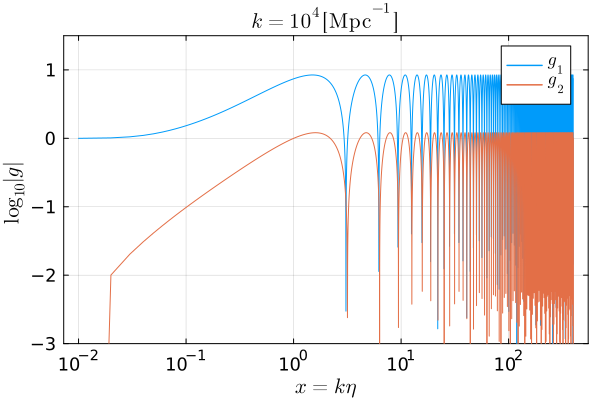

In [72]:
plot(xList, [log10(abs(g1int(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    ylims=(-3,1.5), legend=true)
plot!(xList, [log10(abs(g2int(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

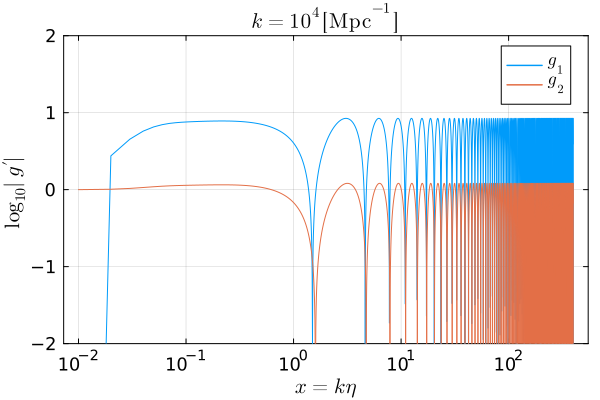

In [73]:
plot(xList, [log10(abs(g1pint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    ylims=(-2,2), legend=true)
plot!(xList, [log10(abs(g2pint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

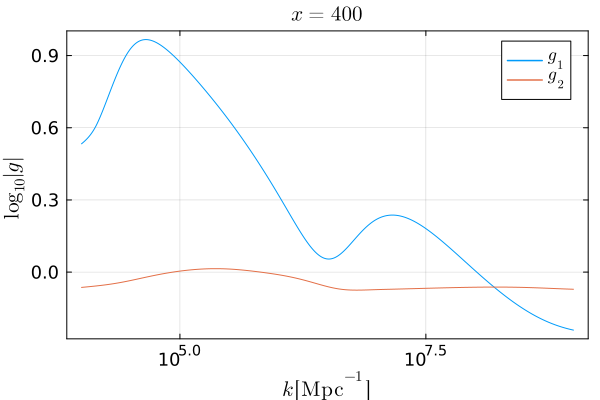

In [74]:
plot(kList, [log10(abs(g1int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$")

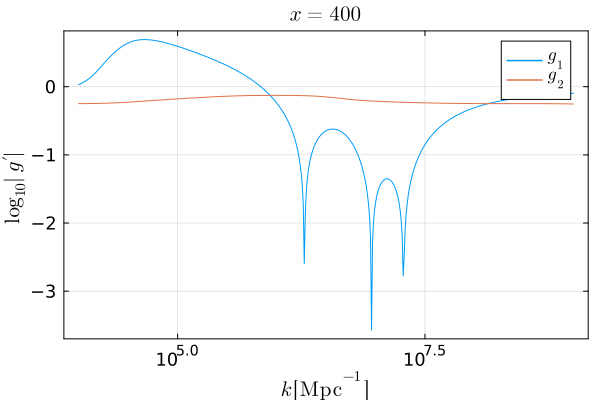

In [75]:
plot(kList, [log10(abs(g1pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$")

In [76]:
normNk(k,x) = g1pint(k,x)g2int(k,x)-g2pint(k,x)g1int(k,x);

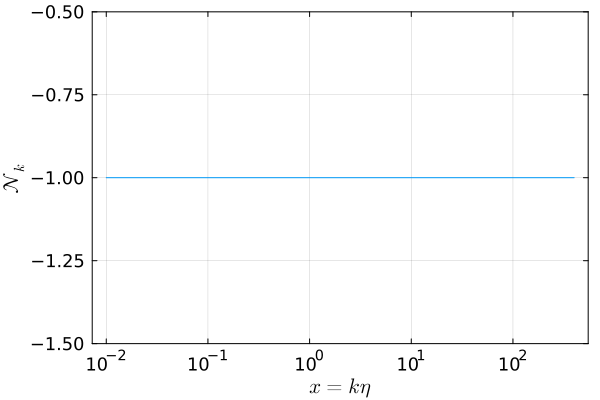

In [77]:
plot(xList, [normNk(1e5,xList[i]) for i=1:length(xList)], xscale=:log10, ylims=(-1.5,-0.5), xlabel=L"$x = k\eta$", ylabel=L"$\mathcal{N}_k$")

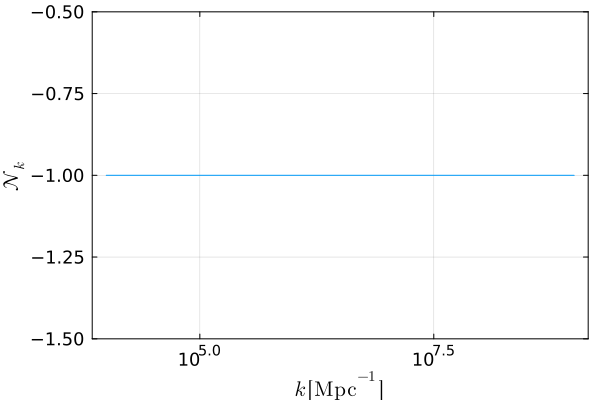

In [78]:
plot(kList, [normNk(kList[i],xi) for i=1:length(kList)], xscale=:log10, ylims=(-1.5,-0.5), xlabel=L"$k\,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\mathcal{N}_k$")

In [79]:
dx = 2*2*π;

function g1g1bar(k)
    f(x) = g1int(k,x)*g1int(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g2g2bar(k)
    f(x) = g2int(k,x)*g2int(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

function g1g2bar(k)
    f(x) = g1int(k,x)*g2int(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

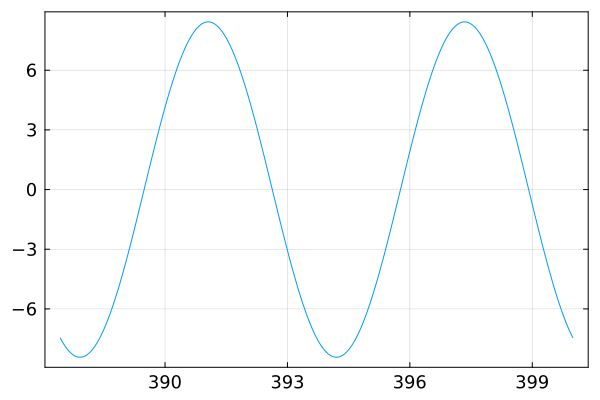

In [80]:
lastxList = [x for x=xf-dx:0.01:xf];

plot(lastxList, [g1int(1e5,lastxList[i]) for i=1:length(lastxList)])

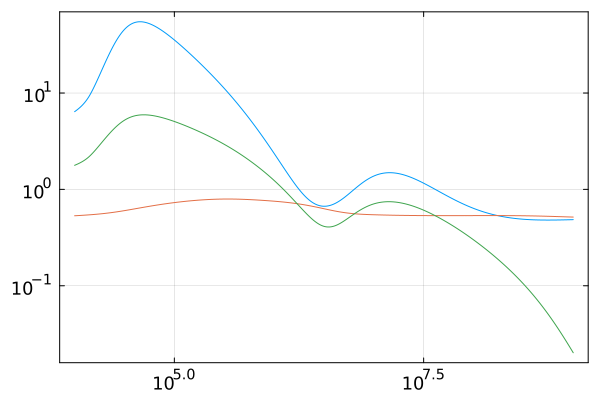

In [81]:
plot(kList, [g1g1bar(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10)
plot!(kList, [g2g2bar(kList[i]) for i=1:length(kList)])
plot!(kList, [g1g2bar(kList[i]) for i=1:length(kList)])

In [92]:
f = open("data/hk.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

hList = reduce(hcat,numarray);


f = open("data/hkp.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

hpList = reduce(hcat,numarray);

In [93]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

hCSI = CubicSplineInterpolation((lnkspan, xspan), hList);
hint(k,x) = hCSI(log10(k),x);

hpCSI = CubicSplineInterpolation((lnkspan, xspan), hpList);
hpint(k,x) = hpCSI(log10(k),x);

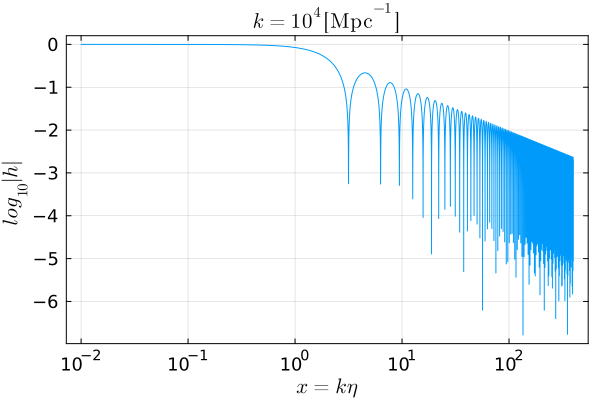

In [94]:
plot(xList, [log10(abs(hint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$log_{10}|h|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

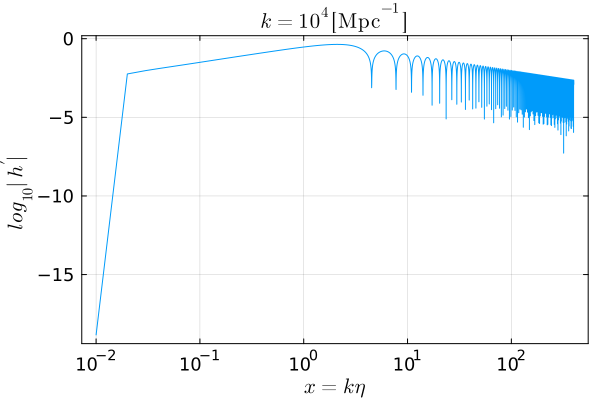

In [95]:
plot(xList, [log10(abs(hpint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$log_{10}|h^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$")

In [96]:
dx = 2*2*π;

function h2bar(k)
    f(x) = hint(k,x)*hint(k,x)
    return quadgk(f,xf-dx,xf)[1]/dx
end;

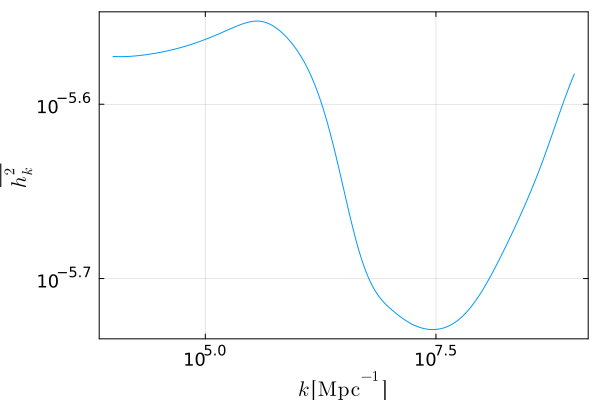

In [97]:
plot(kList, [h2bar(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10, ylabel=L"\overline{h_k^2}", xlabel=L"k\,[\mathrm{Mpc}^{-1}]")

In [98]:
g1g1List = [g1g1bar(kList[i]) for i=1:length(kList)];
g1g2List = [g1g2bar(kList[i]) for i=1:length(kList)];
g2g2List = [g2g2bar(kList[i]) for i=1:length(kList)];
coeffList = [(aint(xf/kList[i])*calHint(xf/kList[i])/aint(etaf)/calHint(etaf))^2 /24*(kList[i]/calHint(xf/kList[i]))^2 *64/81/aint(xf/kList[i])^2 for i=1:length(kList)];
OlinList = [(aint(xf/kList[i])*calHint(xf/kList[i])/aint(etaf)/calHint(etaf))^2 /12*(kList[i]/calHint(xf/kList[i]))^2 * h2bar(kList[i]) for i=1:length(kList)];

In [99]:
open("data/g1g2coeff.dat","w") do out
    Base.print_array(out, hcat(log10.(kList[:]),g1g1List[:],g1g2List[:],g2g2List[:],coeffList[:],OlinList[:]))
end

## load

In [13]:
f = open("data/g1.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

g1List = reduce(hcat,numarray);


f = open("data/g1p.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

g1pList = reduce(hcat,numarray);


f = open("data/g2.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

g2List = reduce(hcat,numarray);


f = open("data/g2p.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

g2pList = reduce(hcat,numarray);

In [14]:
kmin = 1e4;
kmax = 1e9;
kList = [10^lnk for lnk=log10(kmin):0.01:log10(kmax)];

xi = 1e-2;
xf = 400;
xList = [x for x=xi:0.01:xf];

lnkspan = log10(kmin):0.01:log10(kmax);
xspan = xi:0.01:xf;

g1CSI = CubicSplineInterpolation((lnkspan, xspan), g1List);
g1int(k,x) = g1CSI(log10(k),x);

g1pCSI = CubicSplineInterpolation((lnkspan, xspan), g1pList);
g1pint(k,x) = g1pCSI(log10(k),x);

g2CSI = CubicSplineInterpolation((lnkspan, xspan), g2List);
g2int(k,x) = g2CSI(log10(k),x);

g2pCSI = CubicSplineInterpolation((lnkspan, xspan), g2pList);
g2pint(k,x) = g2pCSI(log10(k),x);

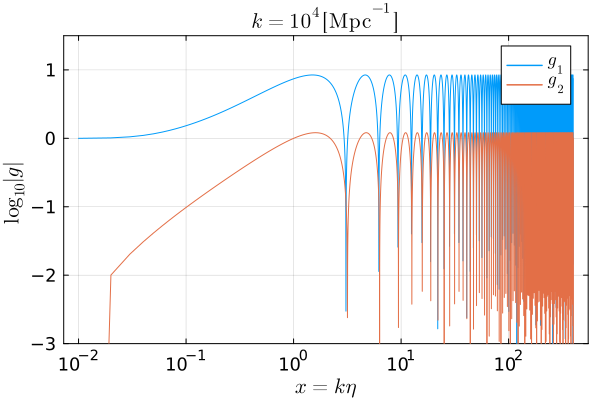

In [15]:
plot(xList, [log10(abs(g1int(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    ylims=(-3,1.5), legend=true)
plot!(xList, [log10(abs(g2int(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

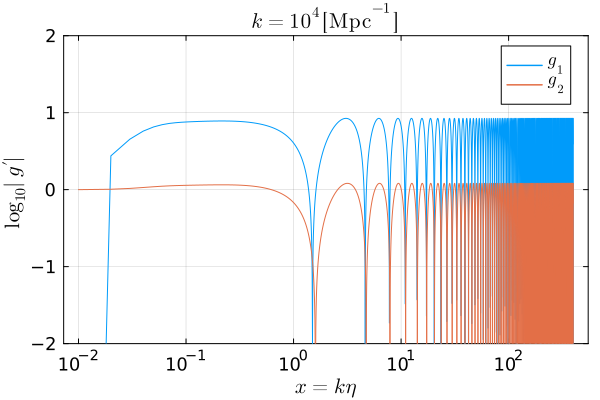

In [16]:
plot(xList, [log10(abs(g1pint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, xlabel=L"$x = k\eta$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$k = 10^4\, [\mathrm{Mpc}^{-1}]$", label=L"$g_1$", 
    ylims=(-2,2), legend=true)
plot!(xList, [log10(abs(g2pint(1e5,xList[i]))) for i=1:length(xList)], xscale=:log10, label=L"$g_2$")

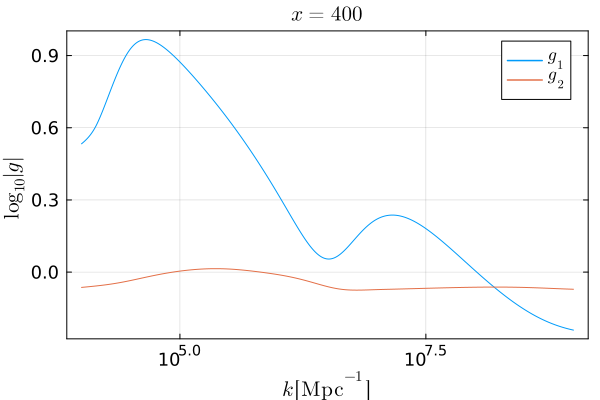

In [17]:
plot(kList, [log10(abs(g1int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2int(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$")

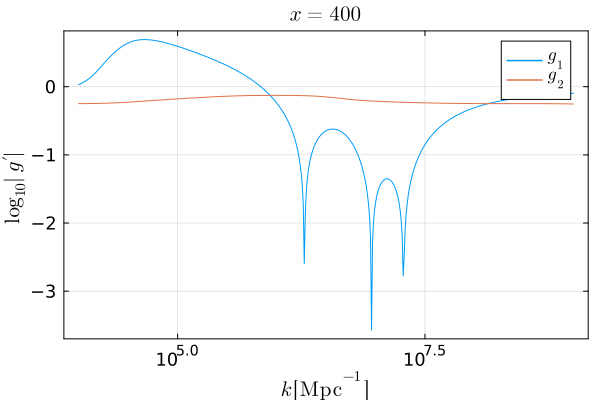

In [18]:
plot(kList, [log10(abs(g1pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k [\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|g^\prime|$", title=L"$x = 400$", label=L"$g_1$", legend=true)
plot!(kList, [log10(abs(g2pint(kList[i],xf))) for i=1:length(kList)], xscale=:log10, label=L"$g_2$")

In [19]:
f = open("data/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [20]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

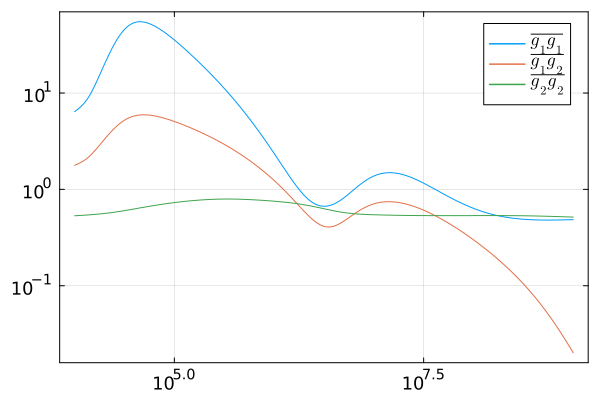

In [21]:
plot(kList, [g1g1int(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10, legend=true, label=L"\overline{g_1g_1}")
plot!(kList, [g1g2int(kList[i]) for i=1:length(kList)], label=L"\overline{g_1g_2}")
plot!(kList, [g2g2int(kList[i]) for i=1:length(kList)], label=L"\overline{g_2g_2}")

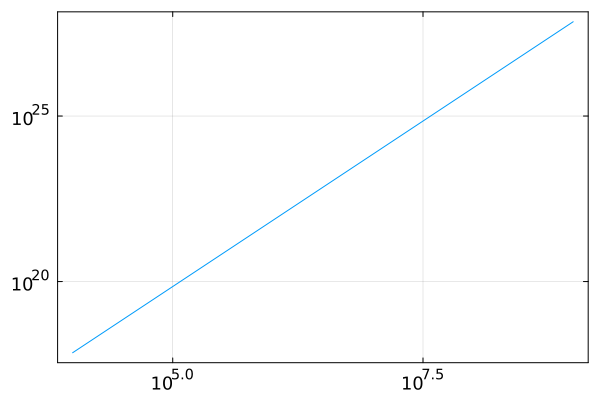

In [22]:
plot(kList, [coeffint(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10)

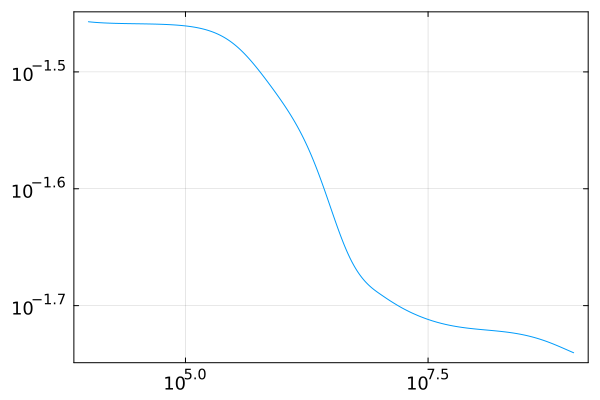

In [23]:
plot(kList, [Olinint(kList[i]) for i=1:length(kList)], xscale=:log10, yscale=:log10)

# Kernel

## calculation

In [24]:
function I1(k,s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            if (x1 < xi || xf < x1 || x2 < xi || xf < x2)
                return 0
            else
                return aint(eta)*g1int(k,x) * (2*Phiint(k1,x1)*Phiint(k2,x2) + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))*(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta)))
            end
        end
        return -quadgk(f,xi,xf)[1]
    end
end;

function I2(k,s,t)
    u = (t+s+1)/2
    v = (t-s+1)/2
    k1 = u*k
    k2 = v*k
    if (k1 < kmin || k1 > kmax || k2 < kmin || k2 > kmax)
        return 0
    else
        function f(x)
            x1 = k1/k*x
            x2 = k2/k*x
            eta = x/k
            if (x1 < xi || xf < x1 || x2 < xi || xf < x2)
                return 0
            else
                return aint(eta)*g2int(k,x) * (2*Phiint(k1,x1)*Phiint(k2,x2) + 4/3/(1+EoSwint(eta))*(Phiint(k1,x1)+Piint(k1,x1)*k1/calHint(eta))*(Phiint(k2,x2)+Piint(k2,x2)*k2/calHint(eta)))
            end
        end
        return -quadgk(f,xi,xf)[1]
    end
end;

function I2bar(k,s,t)
    I1tmp = I1(k,s,t)
    I2tmp = I2(k,s,t)
    return I2tmp^2*g1g1bar(k) - 2*I1tmp*I2tmp*g1g2bar(k) + I1tmp^2*g2g2bar(k)
end;

function I2tab(k,s,t)
    return (t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2*(aint(xf/k)*calHint(xf/k)/aint(etaf)/calHint(etaf))^2 /24*(k/calHint(xf/k))^2 *64/81/aint(xf/k)^2 * I2bar(k,s,t)
end;

lntspan = -3.:0.01:3;
sspan = 0:0.01:1;
tList = [10^lnt for lnt=lntspan];
sList = [s for s=sspan];

function I1List(k)
    I1List = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I1List[i,j] = I1(k,sList[i],tList[j])
        end
    end
    return I1List
end;

function I2List(k)
    I2List = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I2List[i,j] = I2(k,sList[i],tList[j])
        end
    end
    return I2List
end;

function I2barList(k)
    I2barList = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I2barList[i,j] = I2bar(k,sList[i],tList[j])
        end
    end
    return I2barList
end;

function I2tabList(k)
    I2tabList = zeros(length(sList),length(tList))
    Threads.@threads for i=1:length(sList)
        for j=1:length(tList)
            I2tabList[i,j] = I2tab(k,sList[i],tList[j])
        end
    end
    return I2tabList
end;

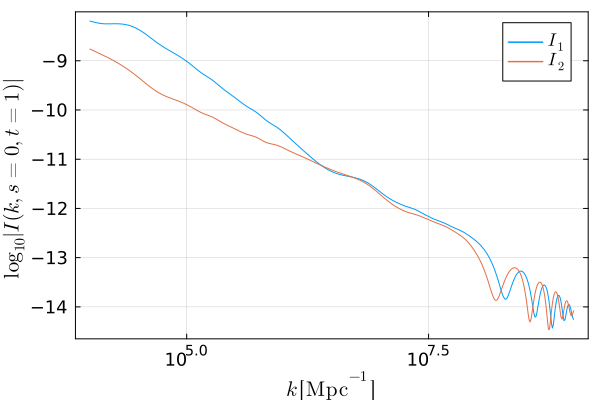

In [25]:
plot(kList, [log10(abs(I1(kList[i],0,1))) for i=1:length(kList)], xscale=:log10, xlabel=L"$k\,[\mathrm{Mpc}^{-1}]$", ylabel=L"$\log_{10}|I(k,s=0,t=1)|$", label=L"$I_1$", legend=true)
plot!(kList, [log10(abs(I2(kList[i],0,1))) for i=1:length(kList)], label=L"$I_2$")

In [26]:
@time I11e6 = I1List(1e6);

215.654051 seconds (28.23 G allocations: 425.520 GiB, 15.60% gc time, 0.12% compilation time)


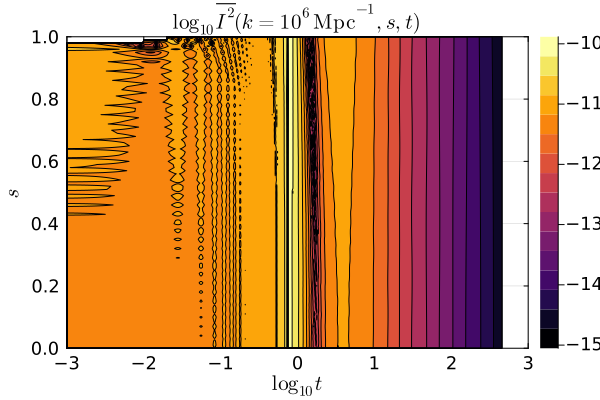

In [27]:
contourf(lntspan,sspan,log10.(abs.(I11e6)), title=L"$\log_{10}\overline{I^2}(k=10^6\,\mathrm{Mpc}^{-1},s,t)$", xlabel=L"$\log_{10}t$", ylabel=L"$s$", legend=true)

In [28]:
[kList[i] for i=101:10:391]

30-element Vector{Float64}:
 100000.0
 125892.54117941661
 158489.3192461114
 199526.23149688786
 251188.6431509582
 316227.7660168379
 398107.1705534969
 501187.2336272725
 630957.344480193
 794328.2347242822
      1.0e6
      1.258925411794166e6
      1.5848931924611141e6
      ⋮
      6.30957344480193e6
      7.943282347242822e6
      1.0e7
      1.2589254117941663e7
      1.5848931924611142e7
      1.9952623149688788e7
      2.5118864315095823e7
      3.162277660168379e7
      3.981071705534969e7
      5.011872336272725e7
      6.3095734448019296e7
      7.943282347242822e7

In [29]:
[string("data/Is/I1_", i, ".dat") for i=201:10:291]

10-element Vector{String}:
 "data/Is/I1_201.dat"
 "data/Is/I1_211.dat"
 "data/Is/I1_221.dat"
 "data/Is/I1_231.dat"
 "data/Is/I1_241.dat"
 "data/Is/I1_251.dat"
 "data/Is/I1_261.dat"
 "data/Is/I1_271.dat"
 "data/Is/I1_281.dat"
 "data/Is/I1_291.dat"

In [ ]:
@time for i=102:200
    if i%10 == 1
        continue
    else
        open(string("data/Is/I1_", i, ".dat"),"w") do out
            Base.print_array(out, I1List(kList[i]))
        end
    end
end;

@time for i=102:200
    if i%10 == 1
        continue
    else
        open(string("data/Is/I2_", i, ".dat"),"w") do out
            Base.print_array(out, I2List(kList[i]))
        end
    end
end;

## load

In [3]:
tmin = 1e-3;
tmax = 1e3;
lntspan = log10(tmin):0.01:log10(tmax);
sspan = 0:0.01:1;

I1table = [zeros(length(sspan),length(lntspan)) for i=1:501];
I2table = [zeros(length(sspan),length(lntspan)) for i=1:501];

for i=101:10:191
    f = open(string("data/Is/I1_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I1table[i] = transpose(reduce(hcat,numarray));
    
    
    f = open(string("data/Is/I2_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I2table[i] = transpose(reduce(hcat,numarray));
end;

for i=201:300
    f = open(string("data/Is/I1_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I1table[i] = transpose(reduce(hcat,numarray));
    
    
    f = open(string("data/Is/I2_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I2table[i] = transpose(reduce(hcat,numarray));
end;

for i=301:10:391
    f = open(string("data/Is/I1_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I1table[i] = transpose(reduce(hcat,numarray));
    
    
    f = open(string("data/Is/I2_",i,".dat"),"r");
    body = readlines(f);
    close(f)

    strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
    numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

    I2table[i] = transpose(reduce(hcat,numarray));
end;

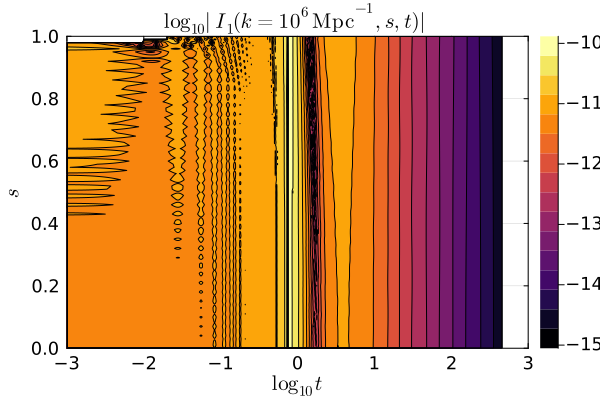

In [9]:
contourf(lntspan,sspan,log10.(abs.(I1table[201])), 
    title=L"$\log_{10}|I_1(k=10^6\,\mathrm{Mpc}^{-1},s,t)|$", xlabel=L"$\log_{10}t$", 
    ylabel=L"$s$", legend=true)

In [5]:
f = open("data/g1g2coeff.dat","r");
body = readlines(f);
close(f)

strarray = [split(body[i],r"\s+",keepempty=false) for i=1:length(body)];
numarray = [parse.(Float64, strarray[i]) for i=1:length(strarray)];

lnkList = [numarray[i][1] for i=1:length(numarray)];
g1g1List = [numarray[i][2] for i=1:length(numarray)];
g1g2List = [numarray[i][3] for i=1:length(numarray)];
g2g2List = [numarray[i][4] for i=1:length(numarray)];
coeffList = [numarray[i][5] for i=1:length(numarray)];
OlinList = [numarray[i][6] for i=1:length(numarray)];

In [6]:
lnkspan = range(lnkList[1], lnkList[length(lnkList)], length=length(lnkList))
kList = [10^lnk for lnk in lnkspan]

g1g1CSI = CubicSplineInterpolation(lnkspan, g1g1List);
g1g1int(k) = g1g1CSI(log10(k));

g1g2CSI = CubicSplineInterpolation(lnkspan, g1g2List);
g1g2int(k) = g1g2CSI(log10(k));

g2g2CSI = CubicSplineInterpolation(lnkspan, g2g2List);
g2g2int(k) = g2g2CSI(log10(k));

coeffCSI = CubicSplineInterpolation(lnkspan, coeffList);
coeffint(k) = coeffCSI(log10(k));

OlinCSI = CubicSplineInterpolation(lnkspan, OlinList);
Olinint(k) = OlinCSI(log10(k));

In [7]:
σ2 = 0.1;
ks = 1e7;
calPz(k) = 1/sqrt(2*π*σ2) * exp(-(log10(k/ks))^2/2/σ2);

function OGW(i)
    I1CSI = CubicSplineInterpolation((sspan, lntspan), I1table[i])
    I1int(s,t) = I1CSI(s,log10(t))
    
    I2CSI = CubicSplineInterpolation((sspan, lntspan), I2table[i])
    I2int(s,t) = I2CSI(s,log10(t))
    
    I2barint(s,t) = I1int(s,t)^2 * g2g2int(kList[i]) - 2*I1int(s,t)*I2int(s,t)*g1g2int(kList[i]) + I2int(s,t)^2 * g1g1int(kList[i])
    
    calPhint(s,t) = (t*(2+t)*(s^2 -1)/(1-s+t)/(1+s+t))^2 * I2barint(s,t) * calPz((t+s+1)/2*kList[i]) * calPz((t-s+1)/2*kList[i])
    
    return coeffint(kList[i]) * dblquad(calPhint,tmin,tmax,0,1)[1]
end;

function OGWList(iGWList)
    OGWList = [0. for i=1:length(iGWList)]
    Threads.@threads for i=1:length(iGWList)
        OGWList[i] = OGW(iGWList[i])
    end
    return OGWList
end;

In [8]:
OGW(391)

0.00029060561676319926

In [38]:
#kGWList = vcat([kList[i] for i=101:10:191], [kList[i] for i=201:300], [kList[i] for i=301:10:391]);
#@time OGWList = vcat([OGW(i) for i=101:10:191], [OGW(i) for i=201:300], [OGW(i) for i=301:10:391]);

iGWList = [i for i=101:10:391];
kGWList = [kList[iGWList[i]] for i=1:length(iGWList)];
@time OGWdata = OGWList(iGWList);

 52.479975 seconds (5.20 G allocations: 80.364 GiB, 14.68% gc time, 5.10% compilation time)


In [39]:
kRDList = [10^lnk for lnk=5:0.01:8];

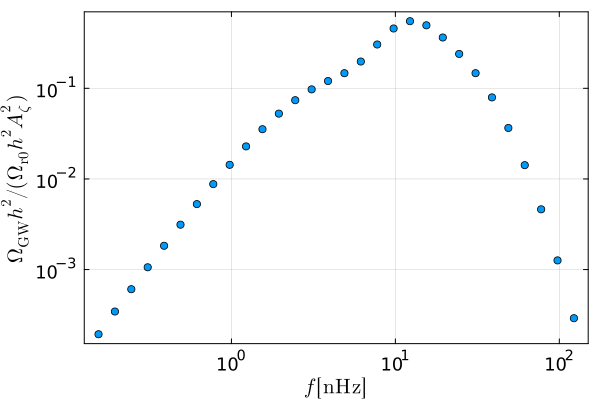

In [40]:
plot(kGWList*MpcinvinHz/2/π*1e9, OGWdata, xlabel=L"$f\,[\mathrm{nHz}]$", ylabel=L"$\Omega_\mathrm{GW}h^2 / (\Omega_{\mathrm{r}0}h^2 A_\zeta^2)$", seriestype=:scatter, 
    #legend=true, label="SIGW", 
    xscale=:log10, yscale=:log10)
#plot!(kRDList*MpcinvinHz/2/π*1e9, [18*Olinint(kRDList[i]) for i=1:length(kRDList)], linestyle=:dash, label="linear")

In [32]:
savefig("OGW_lognormal_0,1.pdf")

"/Users/yuichirotada/Documents/Univ/SIGW_QCD/math/OGW_lognormal_0,1.pdf"